# Result comparaison for Superpixels Entropy

In [1]:
import time
import json
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

import EntropyRateSuperpixel as ERS
import MyDataset as Data
import LambdaCoeff as LC
import SPSbased as SPS
from SLIGbased import SLIC, SNIC, mySNIC

1096 715 102


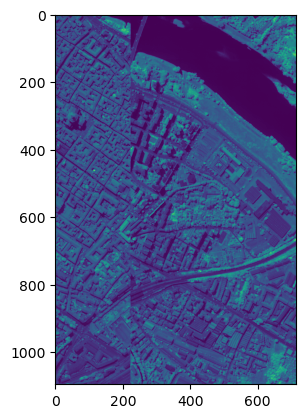

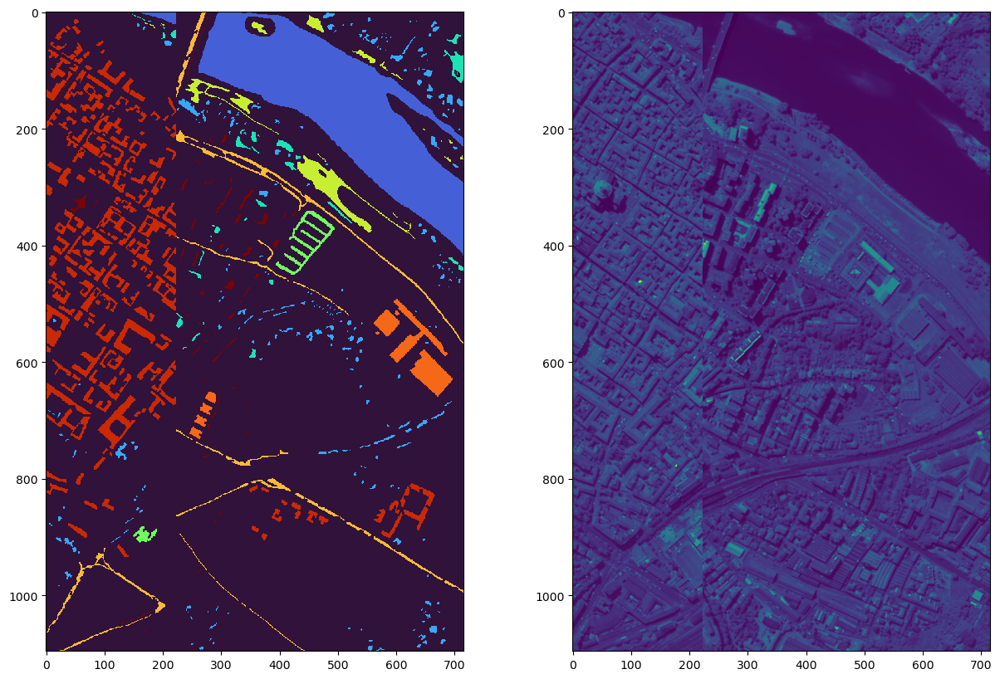

In [28]:
#dataset = Data.IndianPines
#dataset = Data.PaviaUniversity
dataset = Data.PaviaCenter
#dataset = Data.SalinasScene
#dataset = Data.SalinasSceneA

cmap_name = "turbo"
usedDataset = dataset
#usedDataset,_,_ = Data.cropDataset(usedDataset, 200, 200)
N,M,B = usedDataset["shape"]
print(N,M,B)
trainData = Data.standardize_data(usedDataset["data"])

b = np.random.randint(0, B-1)
plt.imshow(trainData[:,:,b])
plt.show()
fig, axs = plt.subplots(1, 2, figsize=(15,10))
axs[0].imshow(usedDataset["gt"], cmap=cmap_name, interpolation="none")
axs[1].imshow(np.average(usedDataset["data"], axis=2))
plt.show()

# Keep Computation

31255


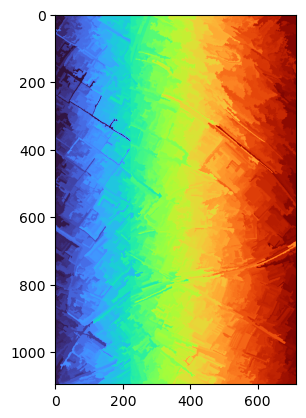

In [29]:
K = 2000
info = SPS.computeMergeBasedInfo(Data.normalized_data(usedDataset["data"]),n_component=0, method="SNIC")
print(len(info[0]))

SPs = SPS.mergedBasedSegmentation(trainData, K,
                                  infos=info,
                                  usedVarFun=SPS.stdFtestnorm1, dist=(2,""),
                                  n_component=0, weighted_avg=True)

img = Data.SPs_to_image(SPs)
plt.imshow(img, cmap="turbo")

In [34]:
Ks = [K]
SPsDic = {K:[SPs]}
names = ["_"]

In [30]:
from scipy.io import savemat #, loadmat

savemat("MResults/" + dataset["name"] + "_" + str(K) + ".mat",
        {"array":img, "K":K, "dataset":dataset["name"]})

## Compute SPs

In [3]:
RunDataFormat = False
useLambdasModel = True

datasetFolder = "datasets/"
saved_file_name = {
    True: "FormatDataSuperpixels",
    False: "SimFunSuperpixels"
}

complete_save_file_name = datasetFolder + saved_file_name[RunDataFormat]
if useLambdasModel and not RunDataFormat:
    complete_save_file_name += "UsedLambdasModel"
complete_save_file_name +=  usedDataset["name"] +".json"
print(complete_save_file_name)

datasets/SimFunSuperpixelsUsedLambdasModelIndian Pines.json


##### Custom computation

In [11]:
Ks = [50, 100, 200, 300, 400, 500, 600]#, 700, 800, 900]
#Ks = [100, 300, 500, 700, 900, 1100, 1300, 1500]
#Ks = [20, 50, 100, 200, 300, 500, 700, 900]


names = ["basic"] + ["std"] + ["Norm1"] 
names = ["norm1"]
names = ["base-line", "std-norm1"]


ns_component = [0, 5, 15]
names += ["ML F-norm1 "+str(n) for n in ns_component]
names += ["ML std-F-norm1"]
#names += ["ML std-F-norm1 "+str(n) for n in ns_component]
#names += ["ML F-norm1-std-exp "+str(n) for n in ns_component]
#names += ["ML cwa-F-norm1 "+str(n) for n in ns_component]
#names += ["ML cwa-std-F-norm1 "+str(n) for n in ns_component]

#names += ["ML DBI "+str(n) for n in ns_component]
#names += ["ML Dunn "+str(n) for n in ns_component]
#names += ["ML XBI "+str(n) for n in ns_component]

#names += ["ML F-norm2 "+str(n) for n in ns_component]
#names += ["ML F-std-norm1 "+str(n) for n in ns_component]
#names += ["ML F-std", "ML F-std²", "ML F-std exp", "ML F-std exp2"]
#names += ["ML F-std-exp"]

#names += ["MB F-test sim1"]
#names += ["MB stdF-test²"]
MB_ns_component = [0, 5, 15]
names += ["MB F-norm1 "+str(n) for n in MB_ns_component]
names += ["MB std-F-norm1"]
#names += ["MB std-norm1 "+str(n) for n in MB_ns_component]
#names += ["MB wavg-norm1 "+str(n) for n in MB_ns_component]
#names += ["MB wavg-std-norm1 "+str(n) for n in MB_ns_component]
#names += ["MB perason "+str(n) for n in MB_ns_component]

names = []
for base in ["", "sdws", "cwa", "sdws-cwa"]:
    for n in [0,3,5,10,15]:
        name = "MB " + base + " (" + str(n) + ")"
        names.append(name)

names = ["ERS-based", "SNIC-based",
         
         "ML sdws", "ERS-MB cwa", "ERS-MB cwa-sdws",
         "SNIC-MB cwa", "SNIC-MB cwa-sdws"]

for base in ["ML", "ERS-MB", "SNIC-MB"]:
    for n in [0,5,10]:
        names.append(base + " (" + str(n) + ")")


#names = ["SLIC", "SNIC", "ERS", "SMCSF"]


datas = names
trainData = Data.standardize_data(trainData)
print(names)
print(Ks)

['ERS-based', 'SNIC-based', 'ML sdws', 'ERS-MB cwa', 'ERS-MB cwa-sdws', 'SNIC-MB cwa', 'SNIC-MB cwa-sdws', 'ML (0)', 'ML (5)', 'ML (10)', 'ERS-MB (0)', 'ERS-MB (5)', 'ERS-MB (10)', 'SNIC-MB (0)', 'SNIC-MB (5)', 'SNIC-MB (10)']
[50, 100, 200, 300, 400, 500, 600]


In [3]:
#Ks = [50, 100, 200, 300, 400, 500, 600]#, 700, 800, 900]
#Ks = [100, 300, 500, 700, 900, 1100, 1300, 1500]
#Ks = [20, 50, 100, 200, 300, 500, 700, 900]

Ks_dic = {
    Data.IndianPines["name"]: [50, 100, 200, 300, 400, 500, 600],
    Data.SalinasScene["name"]: [20, 50, 100, 200, 300, 500, 700, 900],
    Data.PaviaUniversity["name"]: [100, 300, 500, 700, 900, 1100, 1300, 1500]
}
Ks = Ks_dic[usedDataset["name"]]
print(Ks)

SPsDic = {K:[] for K in Ks}
timeDic = {K:[] for K in Ks}

[50, 100, 200, 300, 400, 500, 600]


In [6]:
names = ["average", "norm2", "norm1", "perason"]
datas = names

used_data = Data.normalized_data(usedDataset["data"])
print("ok")
for K in Ks:
    starting_time = time.time()
    SPs = mySNIC(used_data.copy(), K, shape="hexagon", simFun=ERS.average_similarity)
    timeDic[K].append(time.time()-starting_time)
    SPsDic[K].append(SPs)

print("ok")
for K in Ks:
    starting_time = time.time()
    SPs = mySNIC(used_data.copy(), K, shape="hexagon", simFun=ERS.norm2_similarity)
    timeDic[K].append(time.time()-starting_time)
    SPsDic[K].append(SPs)

print("ok")
for K in Ks:
    starting_time = time.time()
    SPs = mySNIC(used_data.copy(), K, shape="hexagon", simFun=ERS.norm1_similarity)
    timeDic[K].append(time.time()-starting_time)
    SPsDic[K].append(SPs)
    
print("ok")
for K in Ks:
    starting_time = time.time()
    SPs = mySNIC(used_data.copy(), K, shape="hexagon", simFun=ERS.perason_correlation)
    timeDic[K].append(time.time()-starting_time)
    SPsDic[K].append(SPs)



ok
ok
ok
ok


In [12]:
# State of the art comp
names = ["SLIC", "SNIC", "ERS", "SMCSF"]
datas = names

starting_time = time.time()
pca_data = SPS.compute_false_greyscale_img(usedDataset["data"])
pca_time = time.time() - starting_time


print("SLIC")
for K in Ks:
    starting_time = time.time()
    SPs = SLIC(pca_data, K, compactness=Data.hyperparameterValue[usedDataset["name"]][K][0])
    timeDic[K].append(time.time()-starting_time + pca_time)
    SPsDic[K].append(SPs)


print("SNIC")
for K in Ks:
    starting_time = time.time()
    SPs = SNIC(pca_data, K, compactness=Data.hyperparameterValue[usedDataset["name"]][K][1])
    timeDic[K].append(time.time()-starting_time + pca_time)
    SPsDic[K].append(SPs)


print("ERS")
lc = [Data.hyperparameterValue[usedDataset["name"]][K][2] for K in Ks]
SPs_dic_i, dic_time = ERS.find_superpixel(pca_data, Ks, lambda_coef=lc, simFun="average", updateLambda=True, time_info=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])
    timeDic[K].append(dic_time[K] + pca_time)


print("SMWSN")
starting_time = time.time()
infos = SPS.computeMergeBasedInfo(Data.normalized_data(usedDataset["data"]), n_component=0, method="SNIC")
info_time = time.time() - starting_time

SPs_dic_i, dic_time = SPS.mergedBasedSegmentation(trainData, Ks, infos=infos,
                                                  usedVarFun=SPS.stdFtestnorm1, dist=(2,""),
                                                  n_component=0, weighted_avg=True,
                                                  info_time=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])
    timeDic[K].append(dic_time[K] + info_time)

SLIC


KeyError: 'Salinas Scene A'

In [5]:
# MethodComp names
names = ["ERS std-norm1", "SNIC nrm-norm2"] 

names += ["ML std-F-norm1", 
          "ERS-MB wavg-F-norm1", "ERS-MB wavg-std-F-norm1",
          "SNIC-MB wavg-F-norm1", "SNIC-MB wavg-std-F-norm1"]

ML_ns_component = [0, 5, 10]
names += ["ML F-norm1 "+str(n) for n in ML_ns_component]

MB_ns_component = [0, 5, 10]
names += ["ERS-MB F-norm1 "+str(n) for n in MB_ns_component]
names += ["SNIC-MB F-norm1 "+str(n) for n in MB_ns_component]
datas = names

nrm_data = Data.normalized_data(usedDataset["data"])

print("ERS")
SPs_dic_i, dic_time = ERS.find_superpixel(trainData, Ks, lambda_coef="auto", simFun="norm1", updateLambda=True, time_info=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])
    timeDic[K].append(dic_time[K])

print("SNIC")
for K in Ks:
    starting_time = time.time()
    SPs = mySNIC(nrm_data, K, shape="hexagon")
    timeDic[K].append(time.time()-starting_time)
    SPsDic[K].append(SPs)


print("info dic")
starting_time = time.time()
Ks_or = SPS.compute_Ks(N,M)
infos_ML = SPS.createMultilevelInfo(trainData, Ks_or)
info_ML_time = time.time() - starting_time

infosDicERS = {}
infos_time_dic_ERS = {}
for n in MB_ns_component:
    starting_time = time.time()
    infosDicERS[n] =  SPS.computeMergeBasedInfo(trainData, n_component=n)
    infos_time_dic_ERS[n] = time.time() - starting_time

infosDicSNIC = {}
infos_time_dic_SNIC = {}
for n in MB_ns_component:
    starting_time = time.time()
    infosDicSNIC[n] =  SPS.computeMergeBasedInfo(nrm_data, n_component=n, method="SNIC")
    infos_time_dic_SNIC[n] = time.time() - starting_time



print("wavg")
print("   ML")
SPs_dic_i, dic_time = SPS.multilevelSPsegmentation(trainData, Ks, n_component=0, infos=infos_ML, varFun=SPS.stdFtestnorm1, dist=(2,""), info_time=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])
    timeDic[K].append(dic_time[K] + info_ML_time)

print("   ERS1")
SPs_dic_i, dic_time = SPS.mergedBasedSegmentation(trainData, Ks, infos=infosDicERS[0], n_component=0, info_time=True, weighted_avg=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])
    timeDic[K].append(dic_time[K] + infos_time_dic_ERS[0])

print("   ERS2")
SPs_dic_i, dic_time = SPS.mergedBasedSegmentation(trainData, Ks, infos=infosDicERS[0], usedVarFun=SPS.stdFtestnorm1, dist=(2,""), n_component=0, info_time=True, weighted_avg=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])
    timeDic[K].append(dic_time[K] + infos_time_dic_ERS[0])

print("   SNIC1")
SPs_dic_i, dic_time = SPS.mergedBasedSegmentation(nrm_data, Ks, infos=infosDicSNIC[0], n_component=0, info_time=True, weighted_avg=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])
    timeDic[K].append(dic_time[K] + infos_time_dic_SNIC[0])

print("   SNIC2")
SPs_dic_i, dic_time = SPS.mergedBasedSegmentation(nrm_data, Ks, infos=infosDicSNIC[0], usedVarFun=SPS.stdFtestnorm1, dist=(2,""), n_component=0, info_time=True, weighted_avg=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])
    timeDic[K].append(dic_time[K] + infos_time_dic_SNIC[0])






print("ML std norm1")
for n in ML_ns_component:
    print(n, end=" ")
    SPs_dic_i, dic_time = SPS.multilevelSPsegmentation(trainData, Ks, n_component=n, infos=infos_ML, info_time=True)
    for K in Ks:
        SPsDic[K].append(SPs_dic_i[K])
        timeDic[K].append(dic_time[K] + info_ML_time)



print("MB")
print("   ERS")
for n in MB_ns_component:
    print(n, end=" ")
    SPs_dic_i, dic_time = SPS.mergedBasedSegmentation(trainData, Ks, infos=infosDicERS[n], n_component=n, info_time=True)
    for K in Ks:
        SPsDic[K].append(SPs_dic_i[K])
        timeDic[K].append(dic_time[K] + infos_time_dic_ERS[n])


print("   SNIC")
for n in MB_ns_component:
    print(n, end=" ")
    SPs_dic_i, dic_time = SPS.mergedBasedSegmentation(nrm_data, Ks, infos=infosDicSNIC[n], n_component=n, info_time=True)
    for K in Ks:
        SPsDic[K].append(SPs_dic_i[K])
        timeDic[K].append(dic_time[K] + infos_time_dic_SNIC[n])


ERS
SNIC
info dic
wavg
   ML
   ERS1
   ERS2
   SNIC1
   SNIC2
ML std norm1
0 5 10 MB
   ERS
0 5 10    SNIC
0 5 10 

In [4]:
# MB names
MB_ns_component = [0, 3, 5, 10, 15]
names = []
names += ["MB norm1 "+str(n) for n in MB_ns_component]
names += ["MB std-norm1 "+str(n) for n in MB_ns_component]
names += ["MB wavg-norm1 "+str(n) for n in MB_ns_component]
names += ["MB wavg-std-norm1 "+str(n) for n in MB_ns_component]
datas = names

method_name = "ERS"
#method_name = "SNIC"
if method_name=="SNIC":
    trainData = Data.normalized_data(usedDataset["data"])
infosDic = {n: SPS.computeMergeBasedInfo(trainData, n_component=n, method=method_name) for n in MB_ns_component}

for n in MB_ns_component:
    print(n)
    SPs_dic_i = SPS.mergedBasedSegmentation(trainData, Ks, infos=infosDic[n], n_component=n)
    for K in Ks:
        SPsDic[K].append(SPs_dic_i[K])

for n in MB_ns_component:
    print(n)
    SPs_dic_i = SPS.mergedBasedSegmentation(trainData, Ks, infos=infosDic[n], usedVarFun=SPS.stdFtestnorm1, dist=(1,""), n_component=n)
    for K in Ks:
        SPsDic[K].append(SPs_dic_i[K])

for n in MB_ns_component:
    print(n)
    SPs_dic_i = SPS.mergedBasedSegmentation(trainData, Ks, infos=infosDic[n], n_component=n, weighted_avg=True)
    for K in Ks:
        SPsDic[K].append(SPs_dic_i[K])

for n in MB_ns_component:
    print(n)
    SPs_dic_i = SPS.mergedBasedSegmentation(trainData, Ks, infos=infosDic[n], usedVarFun=SPS.stdFtestnorm1, dist=(1,""), n_component=n, weighted_avg=True)
    for K in Ks:
        SPsDic[K].append(SPs_dic_i[K])


0
3
5
10
15
0
3
5
10
15
0
3
5
10
15
0
3
5
10
15


In [ ]:
print("basic")
SPs_dic_i = ERS.find_superpixel(usedDataset["data"], Ks, lambda_coef=1, simFun="average", updateLambda=False)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])

print("standardized average")
SPs_dic_i = ERS.find_superpixel(trainData, Ks, lambda_coef="auto",simFun="average", updateLambda=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])

print("norm1")
SPs_dic_i = ERS.find_superpixel(trainData, Ks, lambda_coef="auto",simFun="norm1", updateLambda=True)
for K in Ks:
    SPsDic[K].append(SPs_dic_i[K])

##### classic computation

In [39]:
if RunDataFormat:
    data1 = usedDataset["data"].copy()
    data2 = Data.normalized_data(usedDataset["data"].copy())
    data3 = Data.standardize_data( usedDataset["data"].copy() )
    datas = [data1, data2, data3]
    names = ["Basic", "Normalized", "Standardized"]
else:
    datas = ["average", "norm2", "norm1", "perason"]
    names = ["Average", "Norm2", "Norm1", "Perason"]
    trainData = Data.standardize_data(trainData)
    getLambdas = [LC.getLambdaAverage, LC.getLambdaNorm2, LC.getLambdaNorm1]


FoundLambdaCoeffKey = "DataFormat" if RunDataFormat else "SimilarityFunction"
LambdaCoeffs = Data.FoundLambdaCoeff[FoundLambdaCoeffKey]


if usedDataset["name"] in [Data.IndianPines["name"], Data.PaviaUniversity["name"]]:
    Ks = list(LambdaCoeffs[usedDataset["name"]].keys())
else:
    Ks = [100, 200, 300, 400, 500, 600]

Ks = [200, 500, 800, 1200, 1500, 1800, 2100]
    
if len(Ks)==1:
    complete_save_file_name = complete_save_file_name[:len(complete_save_file_name)-5] + str(Ks[0]) + "SP.json"
    print(complete_save_file_name)
Ks.sort(key=lambda x:x)

print(trainData.shape)
print(Ks)

(512, 217, 204)
[200, 500, 800, 1200, 1500, 1800, 2100]


In [ ]:
def compute_SPs(Ks, save_data=False, find_lambda=True):
    SPsDic = {K:[] for K in Ks}

    if (not RunDataFormat) and useLambdasModel:
        for i,funName in enumerate(datas):
            print("i =", i, "(" + funName + ")")
            SPs_dic_i = ERS.find_superpixel(trainData, Ks,
                                           lambda_coef="auto",
                                           simFun=funName,
                                           updateLambda=True)
            for K in Ks:
                SPsDic[K].append(SPs_dic_i[K])
    
    else:
        SPsDic = {}
        for K in Ks:
            print("K:", K)
            Ps = LC.computePs(K, N, M)

            current_list = []
            for i,data in enumerate(datas):
                print(i, end=" ")
                if RunDataFormat:

                    fun = ERS.create_CSF("average", data)
                    if find_lambda:
                        SPs, coeff = LC.dichotomies_search(data, K, 1, 400, fun, Ps)
                        print("Choosen Coef:", coeff)
                    else:
                        SPs = ERS.find_superpixel(data, K,
                                                lambda_coef=LambdaCoeffs[usedDataset["name"]][K][i],
                                                simFun="average")
                else:
                    if find_lambda:
                        fun = ERS.create_CSF(data, trainData)
                        SPs, coeff = LC.dichotomies_search(trainData, K, 1, 400, fun, Ps)
                        print("Choosen Coef:", coeff)
                    else:
                        lc = LambdaCoeffs[usedDataset["name"]][K][i]
                        SPs = ERS.find_superpixel(trainData, K,
                                                    lambda_coef=lc,
                                                    simFun=data)
                current_list.append(SPs)
            print()
            SPsDic[K] = current_list


    if save_data:
        json_object = json.dumps(SPsDic)
        with open(complete_save_file_name, "w") as f :
            f.write(json_object)
            f.close()
    return SPsDic


SPsDic = compute_SPs(Ks, save_data=True, find_lambda=False)

i = 0 (average)
i = 1 (norm2)
i = 2 (norm1)
i = 3 (perason)


##### Open/Save SPs

In [5]:
json_object = json.dumps(SPsDic)
with open("datasets/MB " + usedDataset["name"] + ".json", "w") as f :
    f.write(json_object)
    f.close()

In [ ]:
with open("datasets/SNIC_MB " + usedDataset["name"] + ".json", "r") as f:
    tempDic = json.load(f)
    f.close()
SPsDic = {}
for key, dataListe in tempDic.items():
    SPsDic[int(key)] = [[[tuple(coor) for coor in SP] for SP in SPsListe] for SPsListe in dataListe]

Ks = list(SPsDic.keys())
Ks.sort()

In [6]:
DicAll = {"SP": SPsDic, "time":timeDic}
json_object = json.dumps(DicAll)
with open("datasets/SOTA " + usedDataset["name"] + ".json", "w") as f :
    f.write(json_object)
    f.close()

In [4]:
with open("datasets/All " + usedDataset["name"] + ".json", "r") as f:
    tempDic = json.load(f)
    f.close()
SPsDic = {}
for key, dataListe in tempDic["SP"].items():
    SPsDic[int(key)] = [[[tuple(coor) for coor in SP] for SP in SPsListe] for SPsListe in dataListe]
Ks = list(SPsDic.keys())
Ks.sort()

timeDic = {}
for key, dataListe in tempDic["time"].items():
    timeDic[int(key)] = [float(t) for t in dataListe]

In [40]:
with open(complete_save_file_name, "r") as f:
    tempDic = json.load(f)
    f.close()
SPsDic = {}
for key, dataListe in tempDic.items():
    SPsDic[int(key)] = [[[tuple(coor) for coor in SP] for SP in SPsListe] for SPsListe in dataListe]

Ks = list(SPsDic.keys())
Ks.sort()

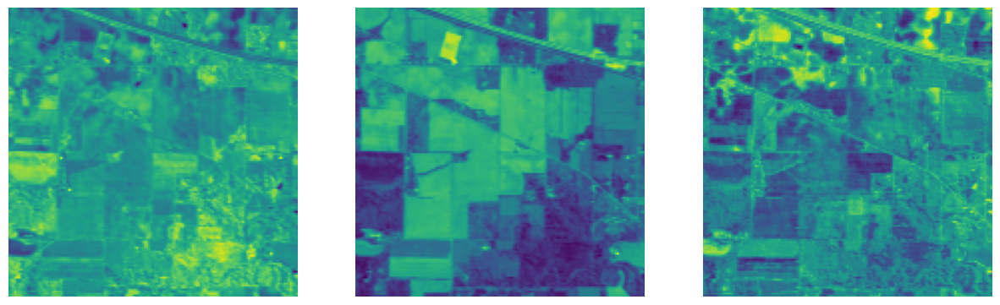

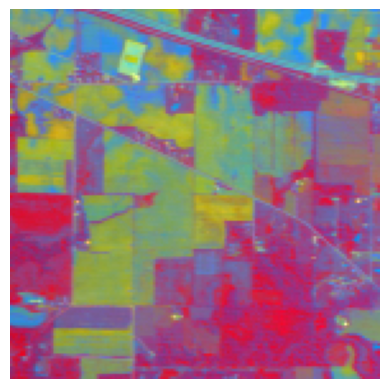

In [ ]:
pca_data = SPS.compute_false_greyscale_img(usedDataset["data"])
fig, axs=  plt.subplots(1,3, figsize=(15,10))
for i in range(3):
    axs[i].imshow(pca_data[:,:,i])
    axs[i].axis("off")
plt.show()

plt.imshow((Data.normalized_data(pca_data)*255).astype(int))
plt.axis("off")
plt.show()

### Superpixels Classifier

In [32]:
ClassifierDic:dict[int, list[ERS.SuperpixelClassifier]] = {}
counting_zeros = [True, False]
for b in counting_zeros:
    print(b)
    ClassifierDic[b] = {}
    for K in Ks:
        ClassifierDic[b][K] = [
            ERS.SuperpixelClassifier(SPs, usedDataset["labels"], usedDataset["gt"], counting0=b)
                    for SPs in SPsDic[K]
            ]

True
False


### Visual result

TypeError: 'AxesSubplot' object is not subscriptable

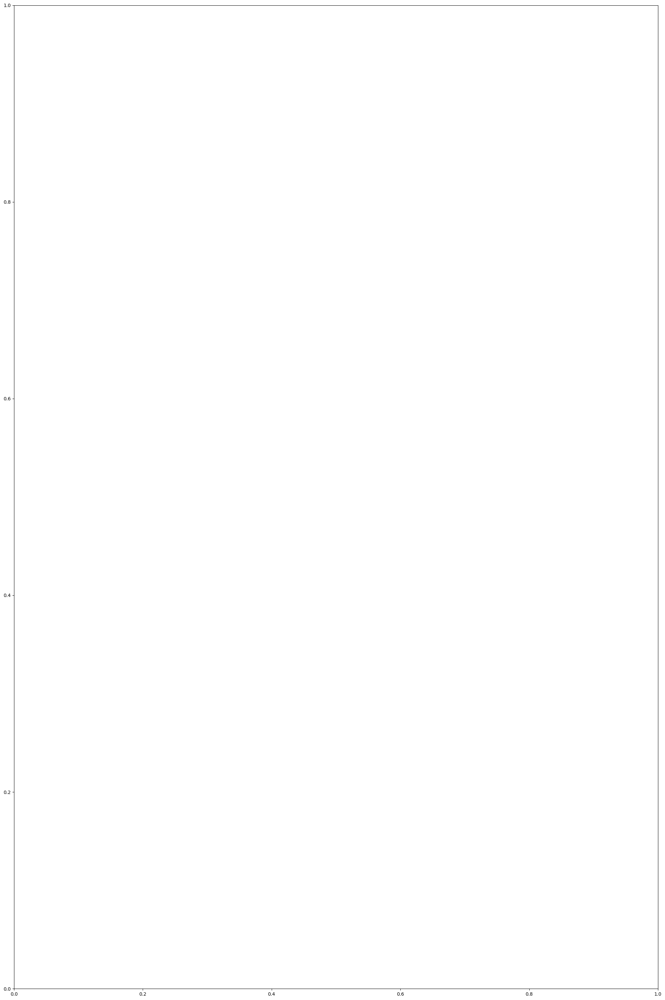

In [ ]:
K = 100
ids = [i for i in range(len(names))]
#ids = [2,0,1,3]
#ids = [5,6,7,8,9]
#ids = [10,11,12,13,14]

fig, axs = plt.subplots(1, len(ids))
fig.set_size_inches(20,30)
fig.tight_layout()
for i in range(len(ids)):
    SP = SPsDic[K][ids[i]]
    axs[i].imshow(usedDataset["gt"], cmap=cmap_name, interpolation="none")
    axs[i].imshow(ERS.create_overlay_borders(usedDataset["gt"], SP, color=[255,255,255,220]))
    axs[i].title.set_text(names[ids[i]])
    axs[i].axis("off")
plt.show()



for b in counting_zeros:
    print(b)
    classifiers = ClassifierDic[b][K]


    imgs = [usedDataset["gt"]] + [ClassifierDic[b][K][id].guess_map for id in ids]
    #imgs = [usedDataset["gt"]] + [C.guess_map for C in classifiers]
    titles = ["ground truth"] + [names[id]+" prediction" for id in ids]


    fig, axs = plt.subplots(1, len(imgs))
    fig.set_size_inches(20,30)
    for i in range(len(imgs)):
        new_img = imgs[i].copy()
        for x in range(N):
            for y in range(M):
                if usedDataset["gt"][x,y]==0:
                    new_img[x,y] = 0
        new_img[0,0] = max(usedDataset["labels"])
        axs[i].imshow(new_img, cmap=cmap_name, interpolation="none")
        axs[i].title.set_text(titles[i])
        axs[i].axis("off")
    plt.show()


    fig, axs = plt.subplots(1, len(imgs))
    fig.set_size_inches(20,30)
    for i in range(len(imgs)):
        new_img = imgs[i].copy()
        new_img[0,0] = max(usedDataset["labels"])
        axs[i].imshow(new_img, cmap=cmap_name, interpolation="none")
        axs[i].title.set_text(titles[i])
        axs[i].axis("off")
    plt.show()


    fig, axs = plt.subplots(1, len(ids))
    fig.set_size_inches(20,30)
    for i in range(1, len(imgs)):
        new_img = np.zeros((N,M))
        for x in range(N):
            for y in range(M):
                if usedDataset["gt"][x,y]!=0 and usedDataset["gt"][x,y]!=imgs[i][x,y]:
                    new_img[x,y] = 1

        axs[i-1].imshow(new_img)
        axs[i-1].title.set_text(titles[i])
        axs[i-1].axis("off")
    plt.show()

    fig, axs = plt.subplots(1, len(ids))
    fig.set_size_inches(20,30)
    for i in range(1, len(imgs)):
        new_img = np.zeros((N,M))
        for x in range(N):
            for y in range(M):
                if usedDataset["gt"][x,y]!=imgs[i][x,y]:
                    new_img[x,y] = 1

        axs[i-1].imshow(new_img)
        axs[i-1].title.set_text(titles[i])
        axs[i-1].axis("off")
    plt.show()


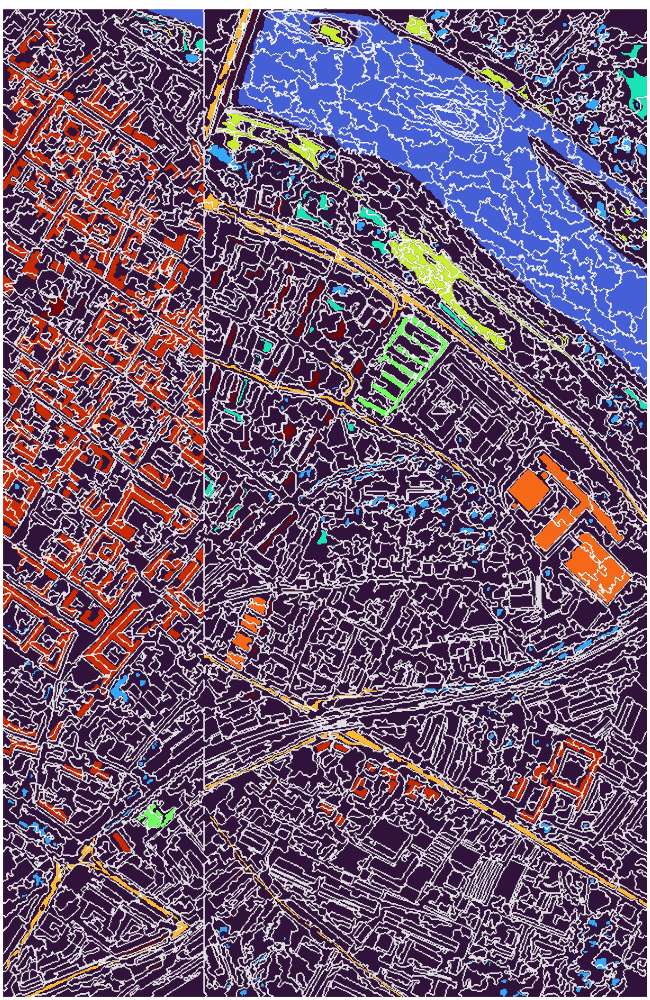

True


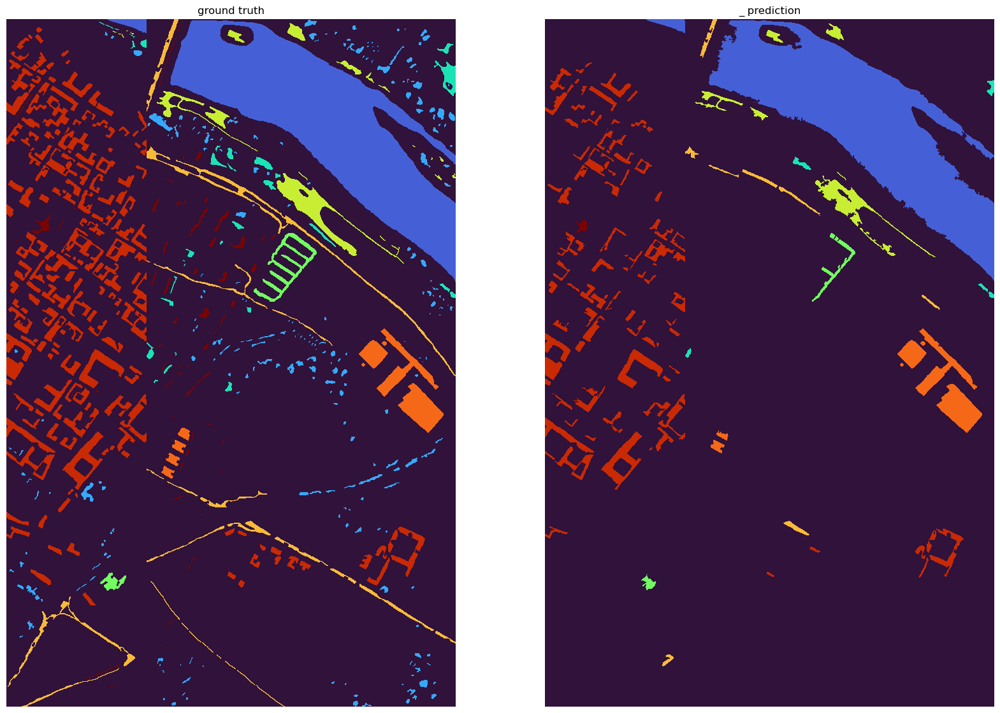

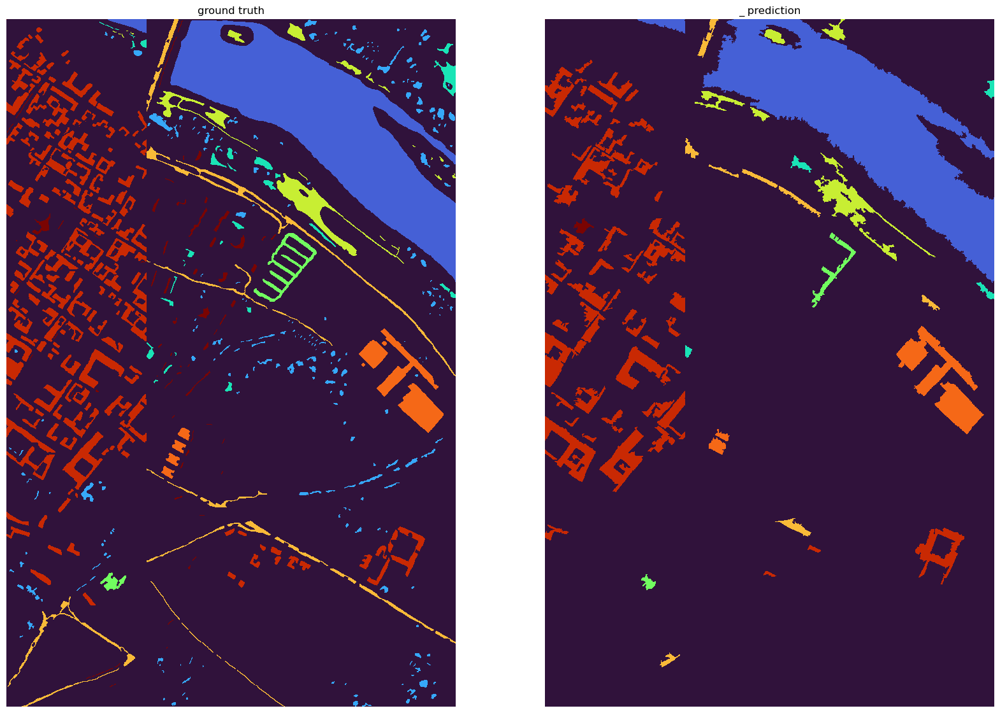

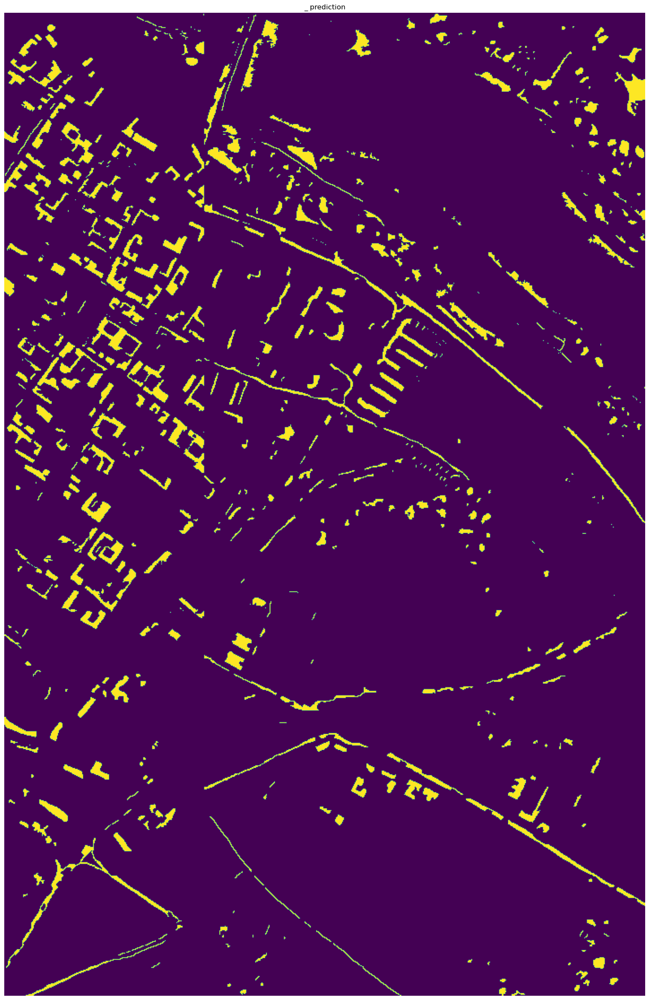

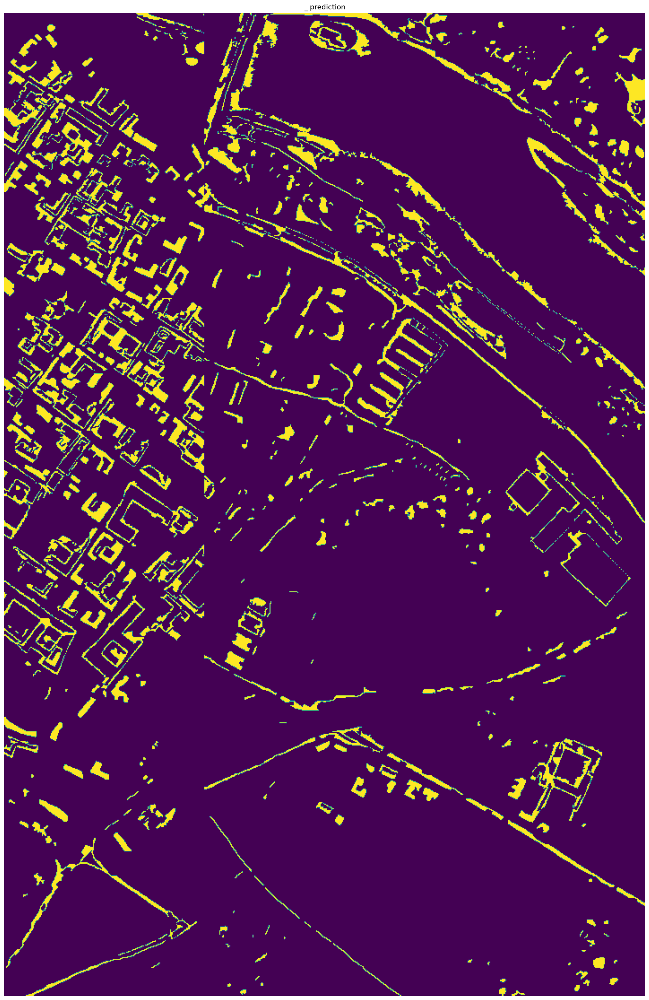

False


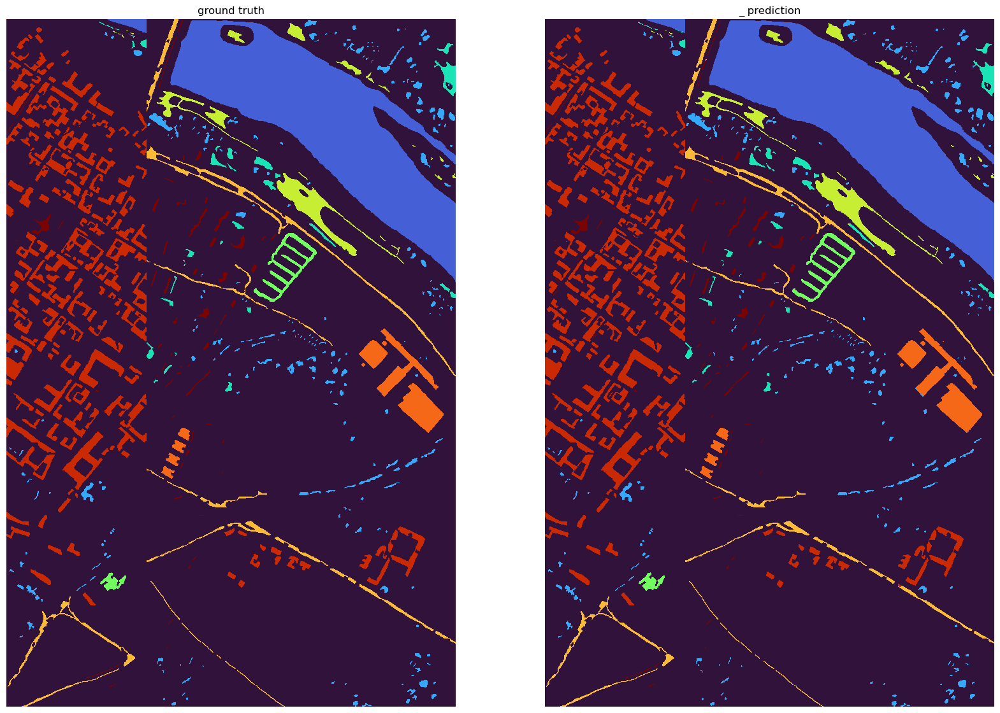

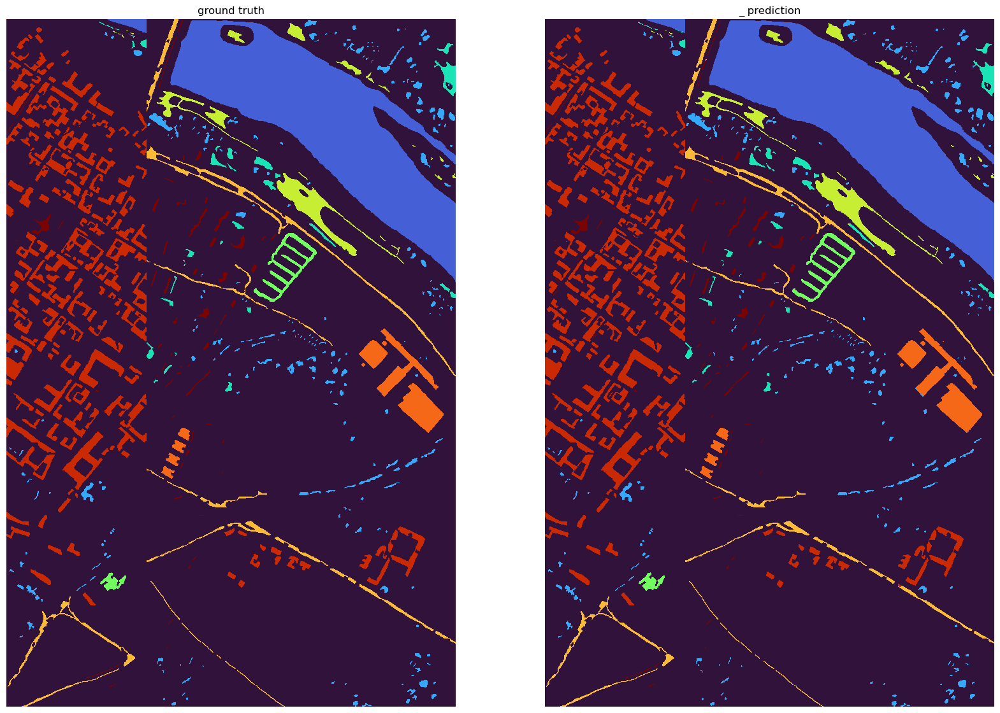

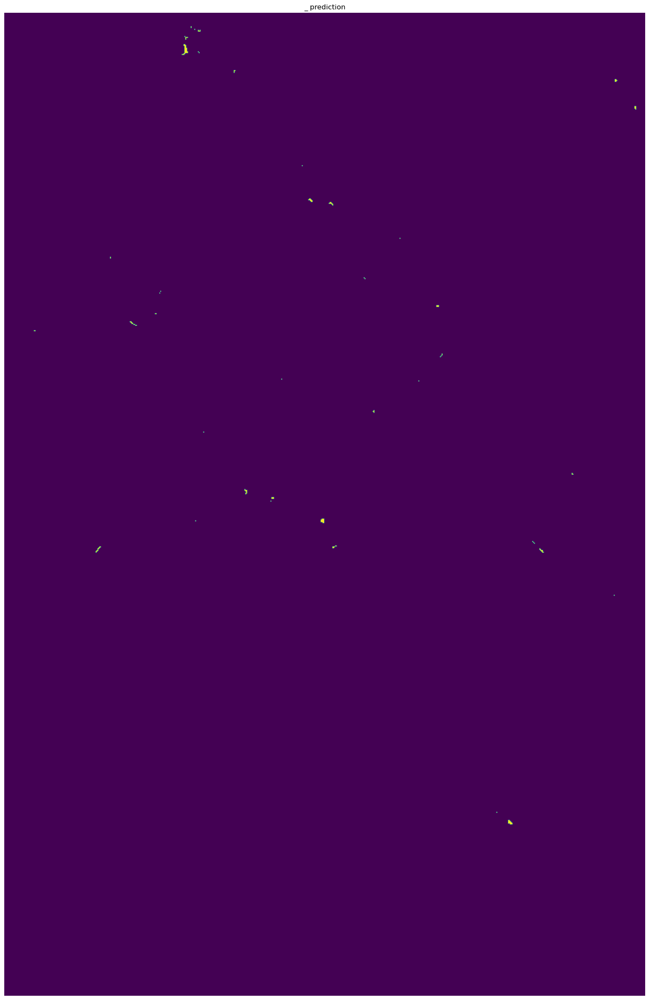

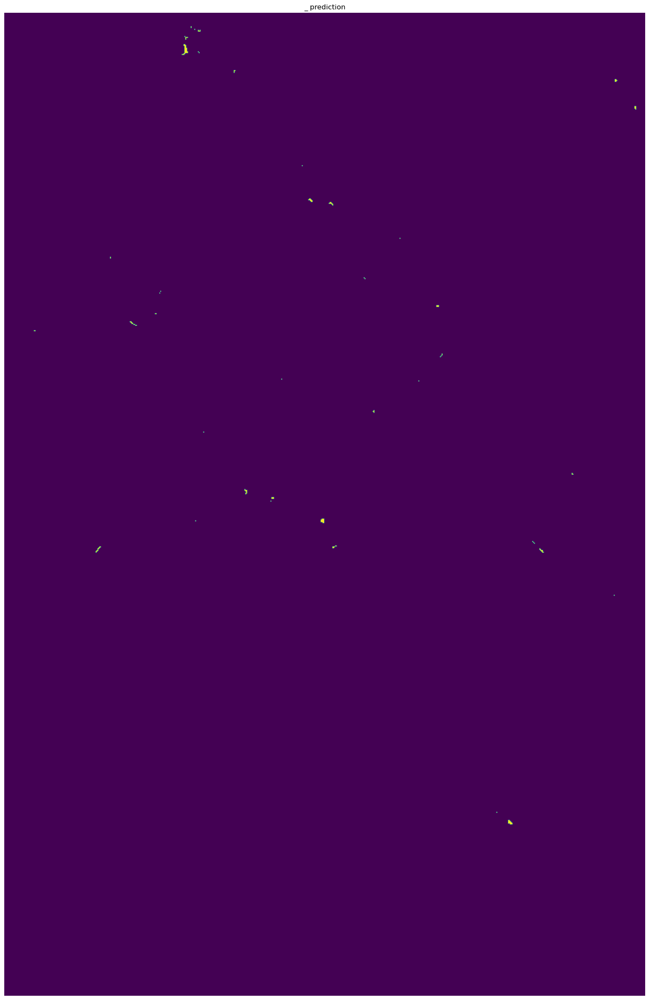

In [37]:
K = 2000

fig, axs = plt.subplots(1, len(ids))
fig.set_size_inches(20,30)
fig.tight_layout()
for i in range(len(ids)):
    SP = SPsDic[K][ids[i]]
    axs.imshow(usedDataset["gt"], cmap=cmap_name, interpolation="none")
    axs.imshow(ERS.create_overlay_borders(usedDataset["gt"], SP, color=[255,255,255,220]))
    axs.title.set_text(names[ids[i]])
    axs.axis("off")
plt.show()



for b in counting_zeros:
    print(b)
    classifiers = ClassifierDic[b][K]


    imgs = [usedDataset["gt"]] + [ClassifierDic[b][K][id].guess_map for id in ids]
    #imgs = [usedDataset["gt"]] + [C.guess_map for C in classifiers]
    titles = ["ground truth"] + [names[id]+" prediction" for id in ids]


    fig, axs = plt.subplots(1, len(imgs))
    fig.set_size_inches(20,30)
    for i in range(len(imgs)):
        new_img = imgs[i].copy()
        for x in range(N):
            for y in range(M):
                if usedDataset["gt"][x,y]==0:
                    new_img[x,y] = 0
        new_img[0,0] = max(usedDataset["labels"])
        axs[i].imshow(new_img, cmap=cmap_name, interpolation="none")
        axs[i].title.set_text(titles[i])
        axs[i].axis("off")
    plt.show()


    fig, axs = plt.subplots(1, len(imgs))
    fig.set_size_inches(20,30)
    for i in range(len(imgs)):
        new_img = imgs[i].copy()
        new_img[0,0] = max(usedDataset["labels"])
        axs[i].imshow(new_img, cmap=cmap_name, interpolation="none")
        axs[i].title.set_text(titles[i])
        axs[i].axis("off")
    plt.show()


    fig, axs = plt.subplots(1, len(ids))
    fig.set_size_inches(20,30)
    for i in range(1, len(imgs)):
        new_img = np.zeros((N,M))
        for x in range(N):
            for y in range(M):
                if usedDataset["gt"][x,y]!=0 and usedDataset["gt"][x,y]!=imgs[i][x,y]:
                    new_img[x,y] = 1

        axs.imshow(new_img)
        axs.title.set_text(titles[i])
        axs.axis("off")
    plt.show()

    fig, axs = plt.subplots(1, len(ids))
    fig.set_size_inches(20,30)
    for i in range(1, len(imgs)):
        new_img = np.zeros((N,M))
        for x in range(N):
            for y in range(M):
                if usedDataset["gt"][x,y]!=imgs[i][x,y]:
                    new_img[x,y] = 1

        axs.imshow(new_img)
        axs.title.set_text(titles[i])
        axs.axis("off")
    plt.show()


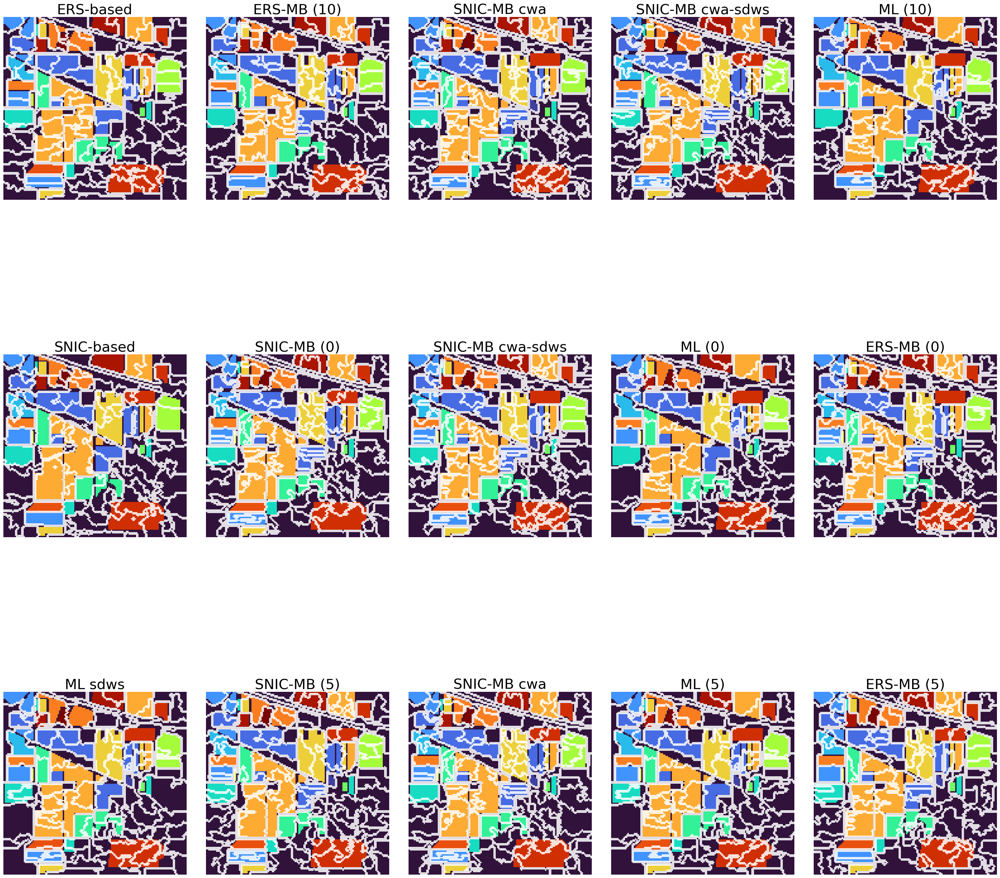

True


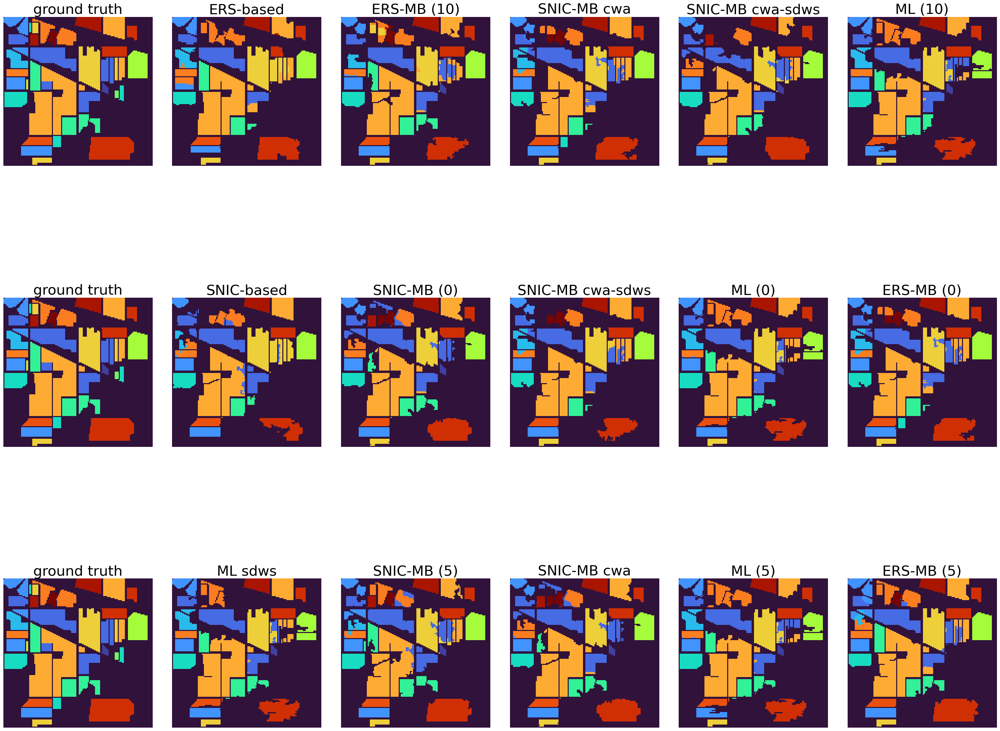

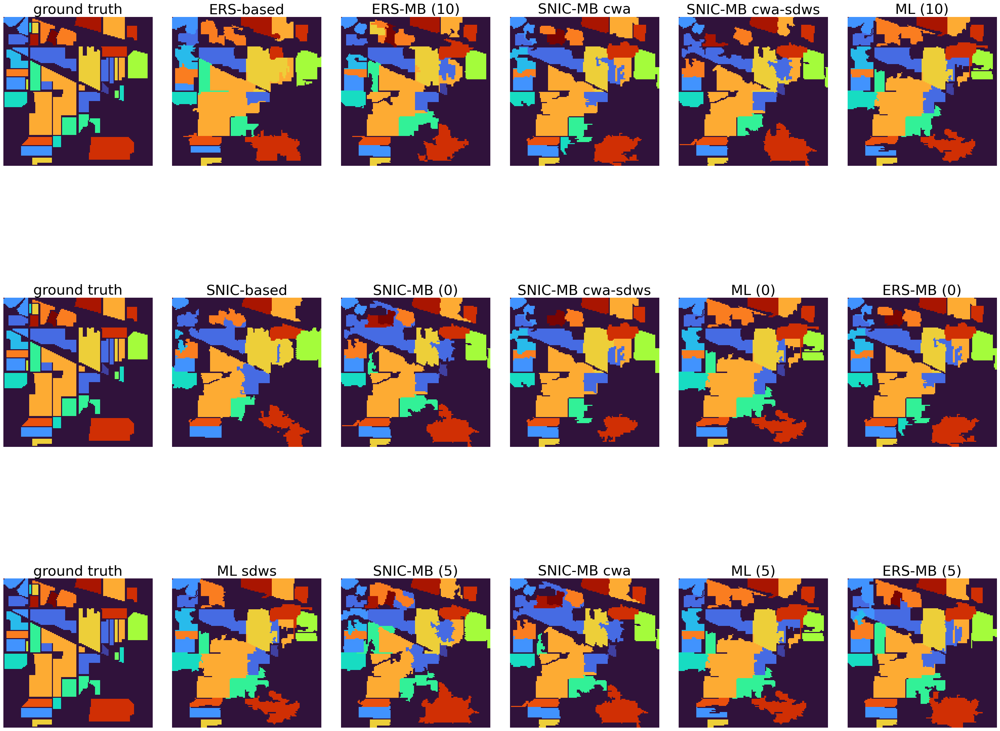

In [7]:
K = 100
ids_list = [0,1,2, 12,13,14, 3,4,5,6,7,8,9,10,11]
ids = np.array(ids_list).reshape((5,3)).T

fig, axs = plt.subplots(3, 5)
fig.set_size_inches(30, 30)
fig.tight_layout()
for i in range(3):
    for j in range(5):
        id = ids[i,j]
        SP = SPsDic[K][id]
        axs[i,j].imshow(usedDataset["gt"], cmap=cmap_name, interpolation="none")
        axs[i,j].imshow(ERS.create_overlay_borders(usedDataset["gt"], SP, color=[255,255,255,220]))
        axs[i,j].title.set_text(names[id])
        axs[i,j].title.set_size(30)
        axs[i,j].axis("off")
plt.show()



for b in counting_zeros:
    print(b)
    classifiers = ClassifierDic[b][K]
    imgs = [ClassifierDic[b][K][id].guess_map for id in range(15)]
    titles = [names[id] for id in range(15)]

    
    fig, axs = plt.subplots(3, 6)
    fig.set_size_inches(30, 25)
    fig.tight_layout()
    for i in range(3):
        for j in range(6):
            if j==0:
                new_img = usedDataset["gt"].copy()
            else:
                id = ids[i,j-1]
                new_img = imgs[id].copy()
            for x in range(N):
                for y in range(M):
                    if usedDataset["gt"][x,y]==0:
                        new_img[x,y] = 0
            new_img[0,0] = max(usedDataset["labels"])
            axs[i,j].imshow(new_img, cmap=cmap_name, interpolation="none")
            title = "ground truth" if j==0 else titles[id]
            axs[i,j].title.set_text(title)
            axs[i,j].title.set_size(30)
            axs[i,j].axis("off")
    plt.show()


    fig, axs = plt.subplots(3, 6)
    fig.set_size_inches(30, 25)
    fig.tight_layout()
    for i in range(3):
        for j in range(6):
            if j==0:
                new_img = usedDataset["gt"].copy()
            else:
                id = ids[i,j-1]
                new_img = imgs[id].copy()
            new_img[0,0] = max(usedDataset["labels"])
            axs[i,j].imshow(new_img, cmap=cmap_name, interpolation="none")
            title = "ground truth" if j==0 else titles[id]
            axs[i,j].title.set_text(title)
            axs[i,j].title.set_size(30)
            axs[i,j].axis("off")
    plt.show()



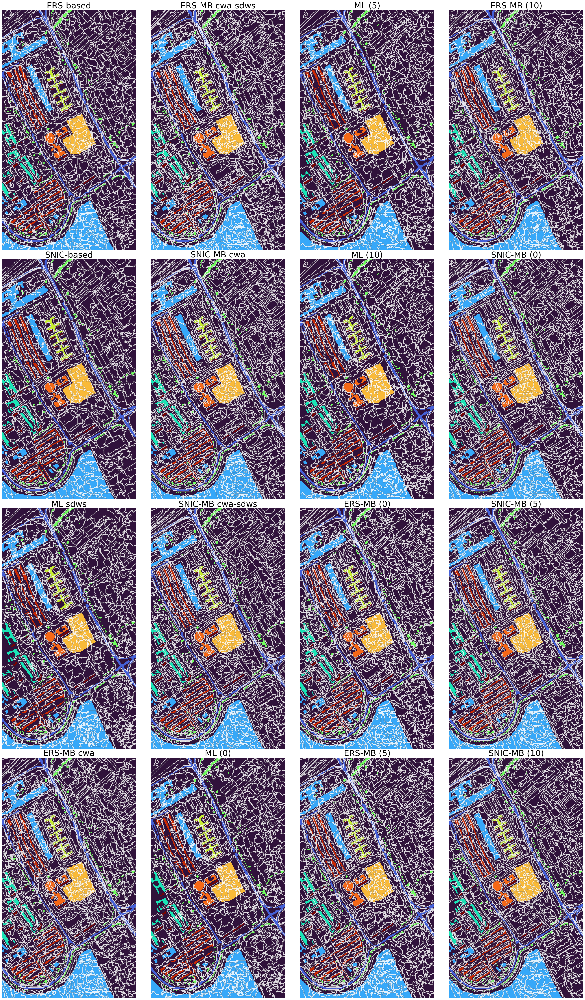

True


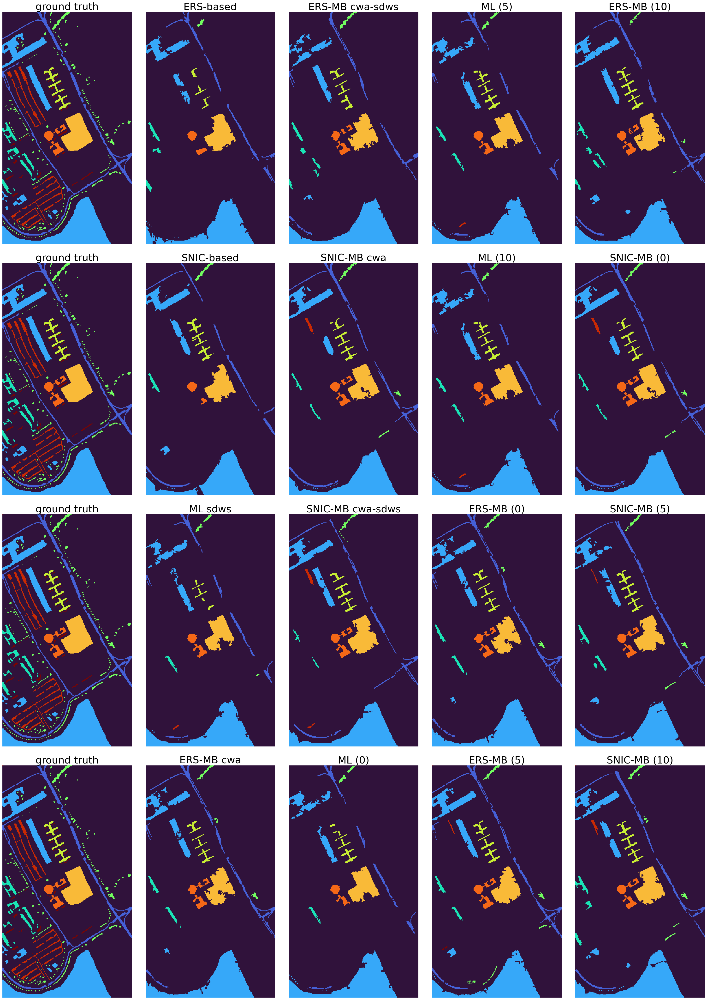

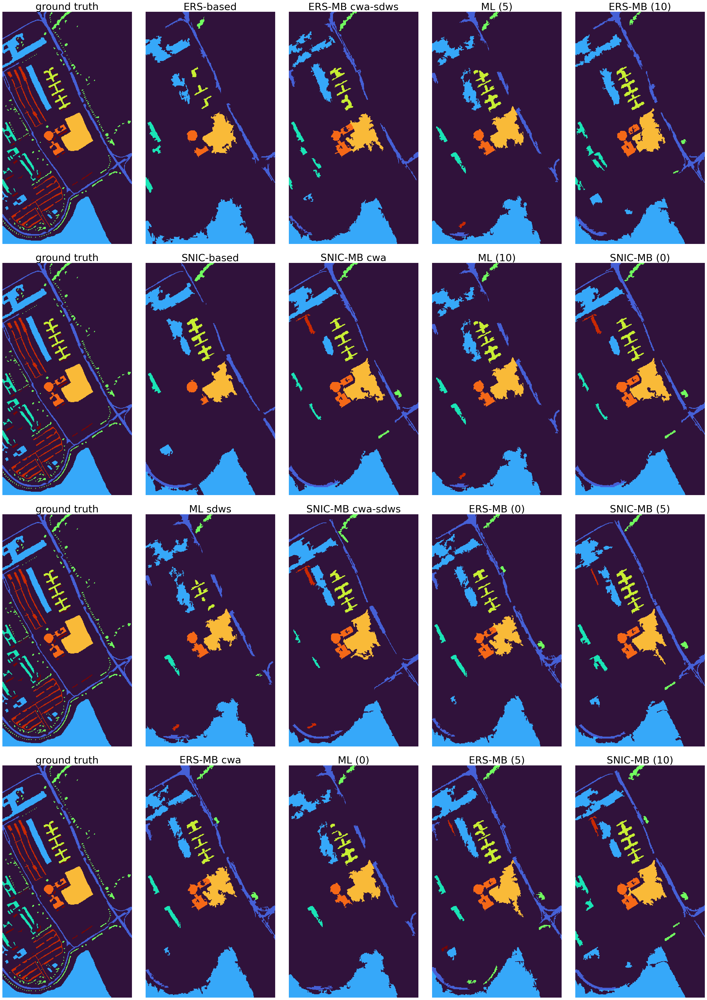

In [7]:
K = 700
ids_list = [id for id in range(len(names))]
ids = np.array(ids_list).reshape((4,4)).T


datasetFigSize = {
    Data.IndianPines["name"] : [30, 25],
    Data.SalinasScene["name"] : [65, 53],
    Data.PaviaUniversity["name"] : [50, 42]
}

fig, axs = plt.subplots(4, 4)
fig.set_size_inches(30, datasetFigSize[usedDataset["name"]][0])
fig.tight_layout()
for i in range(4):
    for j in range(4):
        id = ids[i,j]
        SP = SPsDic[K][id]
        axs[i,j].imshow(usedDataset["gt"], cmap=cmap_name, interpolation="none")
        axs[i,j].imshow(ERS.create_overlay_borders(usedDataset["gt"], SP, color=[255,255,255,220]))
        axs[i,j].title.set_text(names[id])
        axs[i,j].title.set_size(30)
        axs[i,j].axis("off")
plt.show()



for b in counting_zeros:
    print(b)
    classifiers = ClassifierDic[b][K]
    imgs = [ClassifierDic[b][K][id].guess_map for id in range(16)]
    titles = [names[id] for id in range(16)]

    # IP: 30,25
    # PU: 30, 42
    # SS: 30, 53
    fig, axs = plt.subplots(4, 5)
    fig.set_size_inches(30, datasetFigSize[usedDataset["name"]][1])
    fig.tight_layout()
    for i in range(4):
        for j in range(5):
            if j==0:
                new_img = usedDataset["gt"].copy()
            else:
                id = ids[i,j-1]
                new_img = imgs[id].copy()
            for x in range(N):
                for y in range(M):
                    if usedDataset["gt"][x,y]==0:
                        new_img[x,y] = 0
            new_img[0,0] = max(usedDataset["labels"])
            axs[i,j].imshow(new_img, cmap=cmap_name, interpolation="none")
            title = "ground truth" if j==0 else titles[id]
            axs[i,j].title.set_text(title)
            axs[i,j].title.set_size(30)
            axs[i,j].axis("off")
    plt.show()


    fig, axs = plt.subplots(4, 5)
    fig.set_size_inches(30, datasetFigSize[usedDataset["name"]][1])
    fig.tight_layout()
    for i in range(4):
        for j in range(5):
            if j==0:
                new_img = usedDataset["gt"].copy()
            else:
                id = ids[i,j-1]
                new_img = imgs[id].copy()
            new_img[0,0] = max(usedDataset["labels"])
            axs[i,j].imshow(new_img, cmap=cmap_name, interpolation="none")
            title = "ground truth" if j==0 else titles[id]
            axs[i,j].title.set_text(title)
            axs[i,j].title.set_size(30)
            axs[i,j].axis("off")
    plt.show()



### Classification result

In [45]:
size = len(ClassifierDic[True][Ks[0]])
def create_dic_info():
    return {b:{K:[0 for _ in range(size)] for K in Ks} for b in counting_zeros}

def create_label_dic_info():
    return {b:{
        l:{K:[0 for _ in range(size)] for K in Ks} for l in usedDataset["labels"]
    } for b in counting_zeros}

overallAccuracys = create_dic_info()
averageAccuracys = create_dic_info()
#averageWeightedJaccard = create_dic_info()
#singleClassCounts = create_dic_info()
averageWeightedProportions = create_dic_info()
undersegmentationErrors = create_dic_info()
#undersegmentationErrorsNo = create_dic_info()
#boundaryRecalls = create_dic_info()

labelsAccuracy = create_label_dic_info()
#labelsJaccard = create_label_dic_info()

for b in counting_zeros:
    print(b)
    for K in Ks:
        for i,C in enumerate(ClassifierDic[b][K]):
            overallAccuracys[b][K][i] = C.overallAccuracy(usedDataset["gt"])
            averageAccuracys[b][K][i] = C.averageAccuracy(usedDataset["gt"])
            #averageWeightedJaccard[b][K][i] = C.averageWeightedJaccard(usedDataset["gt"], usedDataset["class"])
            #singleClassCounts[b][K][i] = C.singleClassProportion()
            averageWeightedProportions[b][K][i] = C.averageWeightedProportion()
            undersegmentationErrors[b][K][i] = C.undersegmentationError(usedDataset["class"], unique_overlap=True)
            #undersegmentationErrorsNo[b][K][i] = C.undersegmentationError(usedDataset["class"], unique_overlap=False)
            #boundaryRecalls[b][K][i] = C.boundaryRecall(usedDataset["gt"])
        
            for label in usedDataset["labels"]:
                if label in C.labels:
                    labelsAccuracy[b][label][K][i] = C.labelAccuracy(usedDataset["class"], label)
                    #labelsJaccard[b][label][K][i] = C.jaccard(usedDataset["gt"], usedDataset["class"], label)
        

True


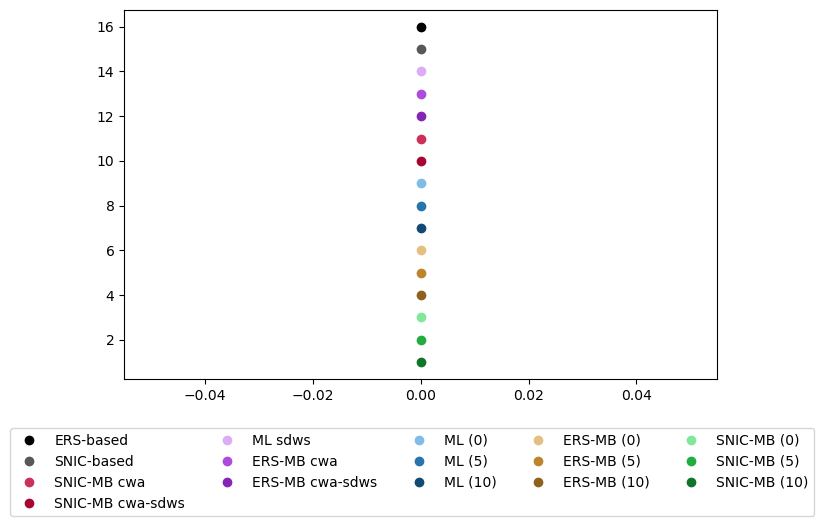

True


NameError: name 'overallAccuracys' is not defined

In [15]:
colors1 = ["black", "gray", "yellow",
            "lightsteelblue", "royalblue", "blue", 
            "lightsalmon", "orangered", "red", "darkred",
            "lightgreen", "springgreen", "seagreen", "darkgreen",
            "pink", "hotpink", "violet", "mediumprchid"
            ]
colors2 = ["black",
          "lightsteelblue", "royalblue", "blue", 
          "lightsalmon", "orangered", "red",
            "lightgreen", "springgreen", "seagreen",
            "pink", "hotpink", "violet"]
colors3 = [
        "#81bce7","#4392ca","#2775ac","#114a72","#07253b",
        "#e7be81","#dfa753","#be842c","#8F611C","#583a0c",
        "#81e799","#4ad26a","#21ac42","#117529","#093c15",
        "#c581e7","#ac51d9","#8425b3","#691a91","#2d0840"
]
colors4 = ["#000000",
          "#81bce7","#3792d3","#0b588f", "#d419e5",
          "#81e799","#32c855","#169533", "#8d0d92"
]
colors5 = ["orange", "mediumseagreen", "royalblue", "violet", "red"]
colors6 = ["#1f77b4", "orange", "black", "red"]
colors7 = [
        "#000000","#585858","#dcacf4", 
        "#ac4bdd","#8425b3","#cc315a","#a70631",
        "#81bce7","#2775ac","#114a72",
        "#e7be81","#be842c","#8F611C",
        "#81e799","#21ac42","#117529",
]
colors = colors7


def plot_info(info, ylabel="", plotbar=False):
    fig, ax = plt.subplots()

    if plotbar:
        for k,K in enumerate(Ks):
            if K!=50:
                for d in range(size):
                    plt.bar(K+ d*20 -20, info[K][d], color=colors[d], width=20)
    else:
        length = len(info[Ks[0]])
        for i in range(length):
            plt.plot(Ks, [info[K][i] for K in Ks], "-o",
                     color=colors[i], linewidth=1, markersize=4)
            
    plt.xlabel("K")
    plt.ylabel(ylabel)
    plt.show()


def plot_label_info(info, ylabel=""):
    fig, axs = plt.subplots(1, len(datas), figsize=(20,10), sharex=True)
    for i in range(len(datas)):
        for label in usedDataset["labels"]:
            if label in info.keys():
                axs[i].plot(Ks, [info[label][K][i] for K in Ks], "-",
                            color=labels_color[label],
                            label=usedDataset["class"][label][0]+" ("+str(len(usedDataset["class"][label][1]))+")")
        axs[i].title.set_text(names[i])
    
    fig.text(0.0, 0.5, ylabel, va='center', rotation='vertical', fontsize=26)

    handles, labels = axs[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=7, bbox_to_anchor=(0.5, -0.0))

    plt.tight_layout()
    plt.subplots_adjust(left=0.05)  
    plt.subplots_adjust(bottom=0.10)
    plt.show()



fig, ax = plt.subplots()

l = [i for i in range(len(datas))]
#l = [2,0,1,3]
l = [0,1,5,6, 2,3,4, 7,8,9,10,11,12,13,14,15]
for i in l:
    plt.plot(0,len(datas)-i,"o", color=colors[i], label=names[i])
handles, labels = ax.get_legend_handles_labels()
ncol = len(datas)
ncol = 5
fig.legend(handles, labels, loc='lower center', ncol=ncol, bbox_to_anchor=(0.5, -0.1))

plt.tight_layout()
plt.subplots_adjust(left=0.05)  
plt.subplots_adjust(bottom=0.20)
plt.show()


plotBar = False
motifs = ["-o", "--s", ":^"]
cmap = mpl.colormaps["viridis"]
labels_color = cmap(np.linspace(0, 1, max(usedDataset["labels"])+1))
for b in counting_zeros:
    print(b)
    bn = "" if b else " without 0 label"
    plot_info(overallAccuracys[b], "Overall Accuracy (%)"+bn, plotbar=plotBar)
    plot_info(averageAccuracys[b], "Average Accuracy (%)"+bn, plotbar=plotBar)
    plot_label_info(labelsAccuracy[b], "Label's accuracy (%)"+bn)
    #plot_info(singleClassCounts[b], "Unique class proportion (%)"+bn, plotbar=plotBar)
    plot_info(averageWeightedProportions[b], "Average Weighted Proportions (%)"+bn, plotbar=plotBar)
    #plot_info(averageWeightedJaccard[b], "Average Weighted Jaccard (%)"+bn, plotbar=plotBar)
    #plot_label_info(labelsJaccard[b], "Label's Jaccard (%)"+bn)
    plot_info(undersegmentationErrors[b], "Undersegmentation Error (%)"+bn, plotbar=plotBar)
    #plot_info(undersegmentationErrorsNo[b], "Undersegmentation Error overalpping"+bn, plotbar=plotBar)
    #plot_info(boundaryRecalls[b], "Boundary Recall (%)"+bn, plotbar=plotBar)

if timeDic!={}:
    plot_info(timeDic, "Computation time (s)", plotbar=plotBar)